## Step01: Downloading the TLC Trip Data
#### The TLC Trip data is downloaded from following website: https://www1.nyc.gov/site/tlc/about/tlc-trip-record-data.page
#### Files need to be downloaded are all the yellow_taxi csv for all months in 2016 & 2019

```
# change this cell to 'Code' if you want run this cell
# the code below is copied from the workshop02
# moving files to corresponding folder after the download, like 2016 files to 'yellow_2016' etc.

import urllib

for month in range(1,13):
    fixed_month = f'{month:02}'
    fname01 = f'yellow_tripdata_2016-{fixed_month}.csv'
    fname02 = f'yellow_tripdata_2019-{fixed_month}.csv'
    
    url01 = f'https://s3.amazonaws.com/nyc-tlc/trip+data/{fname01}'
    url02 = f'https://s3.amazonaws.com/nyc-tlc/trip+data/{fname02}'


    urllib.request.urlretrieve(url01,fname01)
    urllib.request.urlretrieve(url02,fname02)
    
    print(f'Finish Downloading {fname01} & {fname02}')
```

## Step 02: Preprocessing & feature selection & convert csv to feather 

In [1]:
# import all libraries 

import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

import warnings
warnings.filterwarnings("ignore")
from datetime import datetime

#### Preprocessing: 2019 TLC Taxi Data

In [2]:
# 'months' are list of string with each length is 2, like ['01','02'..]
months = [f'{month:02}' for month in range(1,13)]

In [2]:

# select only needed features
features_19 = ['tpep_pickup_datetime','trip_distance','DOLocationID','tip_amount']

# convert each file to feather type
for month in months:
    
    # read csv file and drop rows which contain NaN value
    fname = f'yellow_2019/yellow_tripdata_2019-{month}.csv'
    df = pd.read_csv(fname)[features_19].dropna()
    
    # select trips which start in 2019, the reason is shown below
    df = df.loc[df['tpep_pickup_datetime'].str[:4]=='2019']
    
    # keep only year/month/day/hour for each record, avoid too much NaNs after joining with 'weather.csv'
    df['tpep_pickup_datetime'] = df['tpep_pickup_datetime'].str[:13]
    
    # convert to feather format
    df.reset_index().to_feather(f'yellow_2019/yellow_tripdata_2019-{month}.feather')
    print(f'Finish converting {fname}')

Finish converting yellow_2019/yellow_tripdata_2019-01.csv
Finish converting yellow_2019/yellow_tripdata_2019-02.csv
Finish converting yellow_2019/yellow_tripdata_2019-03.csv
Finish converting yellow_2019/yellow_tripdata_2019-04.csv
Finish converting yellow_2019/yellow_tripdata_2019-05.csv
Finish converting yellow_2019/yellow_tripdata_2019-06.csv
Finish converting yellow_2019/yellow_tripdata_2019-07.csv
Finish converting yellow_2019/yellow_tripdata_2019-08.csv
Finish converting yellow_2019/yellow_tripdata_2019-09.csv
Finish converting yellow_2019/yellow_tripdata_2019-10.csv
Finish converting yellow_2019/yellow_tripdata_2019-11.csv
Finish converting yellow_2019/yellow_tripdata_2019-12.csv


In [3]:
# the reason for selecting data in exact year is there are some outliers or input mistake in the dataset
incorrect_csv01 = pd.read_csv('yellow_2019/yellow_tripdata_2019-01.csv')[features_19].dropna()

In [5]:
# for example, there are some trips which start in 2088, which are not valid
incorrect_csv01.loc[incorrect_csv01['tpep_pickup_datetime'].str[:4]>'2019'].head(2)

,tpep_pickup_datetime,trip_distance,DOLocationID,tip_amount
4157519,2088-01-24 00:15:42,0.63,166,0.0
4165194,2088-01-24 00:25:39,4.05,162,0.0


#### Preprocessing: 2016 TLC Taxi Data from Jan to Jun

In [6]:
# convert yellow_taxi_2016 from first 6 months to feather
# the procedure is similar to 2019 yellow taxi files

features_16 = ['tpep_pickup_datetime','trip_distance','tip_amount']

for month in months[:6]:
    
    fname = f'yellow_2016/yellow_tripdata_2016-{month}.csv'
    df = pd.read_csv(fname)[features_16].dropna()

    df = df.loc[df['tpep_pickup_datetime'].str[:4]=='2016']
    
    df['tpep_pickup_datetime'] = df['tpep_pickup_datetime'].str[:13]

    df.reset_index().to_feather(f'yellow_2016/yellow_tripdata_2016-{month}.feather')
    print(f'Finish converting {fname}')

Finish converting yellow_2016/yellow_tripdata_2016-01.csv
Finish converting yellow_2016/yellow_tripdata_2016-02.csv
Finish converting yellow_2016/yellow_tripdata_2016-03.csv
Finish converting yellow_2016/yellow_tripdata_2016-04.csv
Finish converting yellow_2016/yellow_tripdata_2016-05.csv
Finish converting yellow_2016/yellow_tripdata_2016-06.csv


#### Preprocessing: 2016 TLC Taxi Data from Jul to Dec

In [7]:
# the format of csv file is invalid after June in 2016
incorrect_csv02 = pd.read_csv('yellow_2016/yellow_tripdata_2016-07.csv')

In [9]:
# the first two columns become indexes and the last two columns are missing
print(f'incorrect index for the csv: {incorrect_csv02.index[0]}')
incorrect_csv02.head(2)

incorrect index for the csv: (1, '2016-07-10 06:56:05')


,,VendorID,tpep_pickup_datetime,tpep_dropoff_datetime,passenger_count,trip_distance,RatecodeID,store_and_fwd_flag,PULocationID,DOLocationID,payment_type,fare_amount,extra,mta_tax,tip_amount,tolls_amount,improvement_surcharge,total_amount
1,2016-07-10 06:56:05,2016-07-10 06:59:53,1,0.50,1,N,263,236,1,4.5,1.0,0.5,2.70,0.0,0.3,9.00,NaN,NaN
2,2016-07-10 10:50:18,2016-07-10 10:55:21,5,1.34,1,N,142,163,1,6.0,0.0,0.5,1.36,0.0,0.3,8.16,NaN,NaN


In [10]:
# change the 2016 taxi data after June to valid format and convert to feather type

for month in months[6:]:
    
    # read the file
    fname = f'yellow_2016/yellow_tripdata_2016-{month}.csv'
    df = pd.read_csv(fname)
    
    # assign valid column names to 'columns', reset indexes, drop last two columns and reassign column names
    columns = df.columns
    df= df.reset_index()
    df = df.drop(df.columns[-2:],axis=1)
    df.columns = columns
    
    # feature selection, drop NaN, select rows, remove the minutes and seconds in datetime column
    df = df[features_16].dropna()
    df = df.loc[df['tpep_pickup_datetime'].str[:4]=='2016']
    df['tpep_pickup_datetime'] = df['tpep_pickup_datetime'].str[:13]
    
    # convert csv to feather, print the message
    df.reset_index().to_feather(f'yellow_2016/yellow_tripdata_2016-{month}.feather')
    print(f'Finish converting {fname}')    

Finish converting yellow_2016/yellow_tripdata_2016-07.csv
Finish converting yellow_2016/yellow_tripdata_2016-08.csv
Finish converting yellow_2016/yellow_tripdata_2016-09.csv
Finish converting yellow_2016/yellow_tripdata_2016-10.csv
Finish converting yellow_2016/yellow_tripdata_2016-11.csv
Finish converting yellow_2016/yellow_tripdata_2016-12.csv


#### Preprocessing: weather data
##### The weather data is downloaded from following website: https://openweathermap.org/history-bulk

In [15]:
# read the weather dataset, don't need to convert to feather because it's relatively small
# fill NaN value with 0, the reason is shown below
weather_csv = pd.read_csv('NYC_weather_dataset_2016_2020.csv')
weather_csv.head(1)



,dt,dt_iso,timezone,city_name,lat,lon,temp,feels_like,temp_min,temp_max,...,wind_deg,rain_1h,rain_3h,snow_1h,snow_3h,clouds_all,weather_id,weather_main,weather_description,weather_icon
0,1451606400,2016-01-01 00:00:00 +0000 UTC,-18000,New York,40.712775,-74.005973,7.48,4.31,6.7,8.3,...,0,NaN,NaN,NaN,NaN,90,804,Clouds,overcast clouds,04n


In [4]:
# since both 'rain_1h' and 'snow_1h' doesn't have 0 value, a valid assumption is all NaN means 0 
weather_csv.loc[(weather_csv['rain_1h']==0) | (weather_csv['snow_1h']==0)]

,dt,dt_iso,timezone,city_name,lat,lon,temp,feels_like,temp_min,temp_max,...,wind_deg,rain_1h,rain_3h,snow_1h,snow_3h,clouds_all,weather_id,weather_main,weather_description,weather_icon


In [10]:
weather_csv = weather_csv.fillna(0)
# keep only year, month, day and hour for each record, in order to join with taxi files later
weather_csv['dt_iso'] = weather_csv['dt_iso'].str[:13]

# the dataset contains max_temp & min_temp for each hour, need to make another column using average of these two
weather_csv['avg_temp'] = (weather_csv['temp_max']+weather_csv['temp_min'])/2

# since we focus on all precipitation instead of only rain amount, need to add two columns to get 'tot_prec'
weather_csv['tot_prec'] = weather_csv['rain_1h'] + weather_csv['snow_1h']

# feature selection
weather_features = ['dt_iso','avg_temp','tot_prec']
weather_csv = weather_csv[weather_features]


In [11]:
# weather_19 contains only data in 2019
weather_19 = weather_csv.loc[weather_csv['dt_iso'].str[:4]=='2019']

In [12]:
# weather_16 contains only data in 2016
weather_16 = weather_csv.loc[weather_csv['dt_iso'].str[:4]=='2016']

## Step 03: EDA

#### Annual temperature & precipitation vs Total_Taxi_Demand (2016 & 2019)

In [19]:
# annual_prec_16 & annual_prec_19 are lists of total precipitation for each month
# annual_temp_16 & annual_temp_19 are lists of average temperature for each month


annual_prec_16 = [weather_16.loc[weather_16['dt_iso'].str[5:7]==month]['tot_prec'].sum() for month in months]
annual_prec_19 = [weather_19.loc[weather_19['dt_iso'].str[5:7]==month]['tot_prec'].sum() for month in months]
annual_temp_16 = [weather_16.loc[weather_16['dt_iso'].str[5:7]==month]['avg_temp'].mean() for month in months]
annual_temp_19 = [weather_19.loc[weather_19['dt_iso'].str[5:7]==month]['avg_temp'].mean() for month in months]

In [20]:
%%time
# taxi_demand_16 is a list of total number of rows (taxi demand) for each month in 2016 
# taxi_demand_19 is a list of total number of rows (taxi demand) for each month in 2019 


taxi_demand_16 = []
taxi_demand_19 = []

for month in months:
    tot_taxi_16 = pd.read_feather(f'yellow_2016/yellow_tripdata_2016-{month}.feather').drop('index', axis=1).shape[0]
    tot_taxi_19 = pd.read_feather(f'yellow_2019/yellow_tripdata_2019-{month}.feather').drop('index', axis=1).shape[0]
    taxi_demand_16.append(tot_taxi_16)
    taxi_demand_19.append(tot_taxi_19)

CPU times: user 19.3 s, sys: 12.1 s, total: 31.5 s
Wall time: 20.1 s


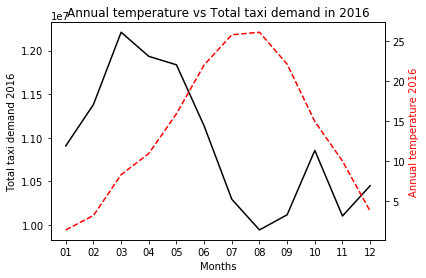

In [22]:
# plot the average temperature vs total taxi demand for each month in 2016

fig, ax1 = plt.subplots()

ax2 = ax1.twinx()
ax1.plot(months, taxi_demand_16, 'k-')
ax2.plot(months, annual_temp_16, 'r--')

ax1.set_xlabel('Months')
ax1.set_ylabel('Total taxi demand 2016', color='k')
ax2.set_ylabel('Annual temperature 2016', color='r')

plt.title('Annual temperature vs Total taxi demand in 2016')

plt.savefig('plots/Annual_temperature_vs_Total_taxi_demand_in_2016.png')
plt.show()

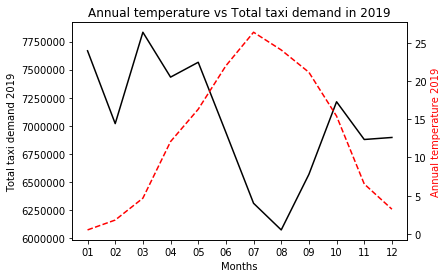

In [23]:
# plot the average temperature vs total taxi demand for each month in 2019

fig, ax1 = plt.subplots()

ax2 = ax1.twinx()
ax1.plot(months, taxi_demand_19, 'k-')
ax2.plot(months, annual_temp_19, 'r--')

ax1.set_xlabel('Months')
ax1.set_ylabel('Total taxi demand 2019', color='k')
ax2.set_ylabel('Annual temperature 2019', color='r')

plt.title('Annual temperature vs Total taxi demand in 2019')

plt.savefig('plots/Annual_temperature_vs_Total_taxi_demand_in_2019.png')



plt.show()

In [27]:
%%time

# In order to check whether precipitation is a factor for total taxi demand, we use the ratio between taxi demand
# under precipitation and total demand for each month instead of total taxi demand
# The reason is each month has different taxi demand, we want to reduce the influence caused by other factor 
# like temperature. 

# prec_demand_ratio_16 is the list of ratio for each month
# prec_datetime_16 is a dataframe comes from weather_16 with only datetime and amount of total precipitation columns
# and amount of precipitation is greater than 0

prec_demand_ratio_16 = []
prec_datetime_16 = weather_16.loc[weather_16['tot_prec'] > 0][['dt_iso','tot_prec']]

for month in months:
    # read the data and total demand for each month is the first element of shape of dataframe
    df = pd.read_feather(f'yellow_2016/yellow_tripdata_2016-{month}.feather').drop('index', axis=1)['tpep_pickup_datetime']
    tot_demand = df.shape[0]
    
    # joining the dataframe with weather data by the datetime column
    meta_df = pd.merge(df, prec_datetime_16, left_on='tpep_pickup_datetime', right_on='dt_iso').drop('dt_iso',axis=1)
    prec_demand = meta_df.shape[0]
    
    # ratio is taxi demand under precipitation divided by total demand for each month, add ratio to list
    ratio = prec_demand/tot_demand
    prec_demand_ratio_16.append(ratio)

CPU times: user 27.3 s, sys: 9.8 s, total: 37.1 s
Wall time: 25.8 s


In [28]:
%%time

# the procedure below is same with above except the time is in 2019
prec_demand_ratio_19 = []
prec_datetime_19 = weather_19.loc[weather_19['tot_prec'] > 0][['dt_iso','tot_prec']]

for month in months:
    df = pd.read_feather(f'yellow_2019/yellow_tripdata_2019-{month}.feather').drop('index', axis=1)['tpep_pickup_datetime']
    tot_demand = df.shape[0]
    
    meta_df = pd.merge(df, prec_datetime_19, left_on='tpep_pickup_datetime', right_on='dt_iso').drop('dt_iso',axis=1)
    prec_demand = meta_df.shape[0]
    
    ratio = prec_demand/tot_demand
    prec_demand_ratio_19.append(ratio)

CPU times: user 21.2 s, sys: 7.95 s, total: 29.1 s
Wall time: 18 s


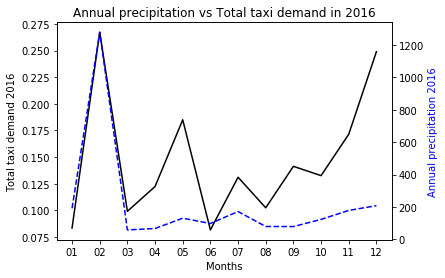

In [29]:
# plot the sum of precipitation vs ratio between prec_demand and tot_demand for each month in 2016

fig, ax1 = plt.subplots()

ax2 = ax1.twinx()
ax1.plot(months, prec_demand_ratio_16, 'k-')
ax2.plot(months, annual_prec_16, 'b--')

ax1.set_xlabel('Months')
ax1.set_ylabel('Total taxi demand 2016', color='k')
ax2.set_ylabel('Annual precipitation 2016', color='b')

plt.title('Annual precipitation vs Total taxi demand in 2016')


plt.savefig('plots/Annual_precipitation_vs_Total_taxi_demand_in_2016.png')


plt.show()

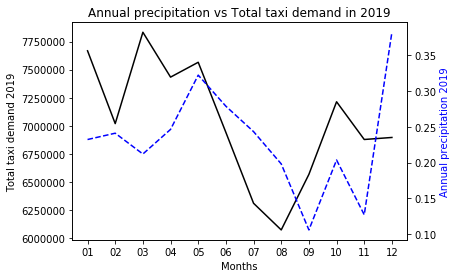

In [30]:
# plot the sum of precipitation vs ratio between prec_demand and tot_demand for each month in 2019

fig, ax1 = plt.subplots()

ax2 = ax1.twinx()
ax1.plot(months, taxi_demand_19, 'k-')
ax2.plot(months, prec_demand_ratio_19, 'b--')

ax1.set_xlabel('Months')
ax1.set_ylabel('Total taxi demand 2019', color='k')
ax2.set_ylabel('Annual precipitation 2019', color='b')

plt.title('Annual precipitation vs Total taxi demand in 2019')
plt.savefig('plots/Annual_precipitation_vs_Total_taxi_demand_in_2019.png')



plt.show()

#### Annual temperature & precipitation vs Trip_Distance (2019)

In [31]:
%%time

# the distance_series is a series contains all distance for a trip without precipitation
# the prec_distance_series is a series contains all distance for a trip with precipitation
distance_series = pd.Series() 
prec_distance_series = pd.Series() 

for month in months:
    
    # open the file and select rows with trip_distance between 0 and 10
    df = pd.read_feather(f'yellow_2019/yellow_tripdata_2019-{month}.feather').drop('index', axis=1)[['tpep_pickup_datetime','trip_distance']]
    df = df.loc[(df['trip_distance']>0) & (df['trip_distance']<10)]
    
    # merge the df with whole weather dataset for 2019
    meta_df = pd.merge(df, weather_19, left_on='tpep_pickup_datetime', right_on='dt_iso').drop('dt_iso',axis=1)
    
    # assign the trip_distance in each case to variable
    distance_with_prec = meta_df.loc[meta_df['tot_prec']>0]['trip_distance']
    distance_without_prec = meta_df.loc[meta_df['tot_prec']==0]['trip_distance']
    
    # append the variable to the distance series
    distance_series = distance_series.append(distance_without_prec)
    prec_distance_series = prec_distance_series.append(distance_with_prec)
    

CPU times: user 55.5 s, sys: 21.4 s, total: 1min 16s
Wall time: 39.6 s


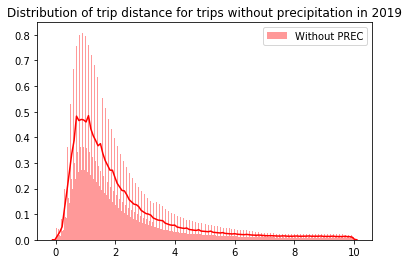

mean of trip distance without PREC: 2.18
variance of trip distance without PREC: 3.56


In [32]:
# plot the distribution of trip distance for trips without precipitation in 2019
sns.distplot(distance_series, bins=300,label= 'Without PREC', color = 'red')

plt.title('Distribution of trip distance for trips without precipitation in 2019')
plt.legend()

plt.savefig('plots/Distribution_of_trip_distance_for_trips_without_precipitation_in_2019.png')


plt.show()

# print the test statistic for analysing
print("mean of trip distance without PREC: {:.2f}".format(distance_series.mean()))

print("variance of trip distance without PREC: {:.2f}".format(distance_series.var()))



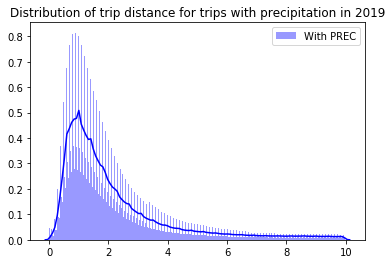

mean of trip distance with PREC: 2.17
variance of trip distance with PREC: 3.58


In [33]:
# plot the distribution of trip distance for trips with precipitation in 2019


sns.distplot(prec_distance_series, bins=300,label='With PREC', color = 'blue')
plt.title('Distribution of trip distance for trips with precipitation in 2019')
plt.legend()

plt.savefig('plots/Distribution_of_trip_distance_for_trips_with_precipitation_in_2019.png')


plt.show()

print("mean of trip distance with PREC: {:.2f}".format(prec_distance_series.mean()))


print("variance of trip distance with PREC: {:.2f}".format(prec_distance_series.var()))




In [34]:
%%time
# df_lst is a list of dataframe for each month with only temperature and trip_distance
# In order to save time and gives enough sample between different temperature to make the statistic more confident,
# we need to convert temperature to int 
df_lst = []
weather_19['temp_int'] = weather_19['avg_temp'].astype(int)

for month in months:
    # read the file and select needed features
    df = pd.read_feather(f'yellow_2019/yellow_tripdata_2019-{month}.feather').drop('index', axis=1)[['tpep_pickup_datetime', 'trip_distance']]
    
    # merge df with weather_19 using the datetime, drop these two columns after merging
    meta_df = pd.merge(df, weather_19[['dt_iso','temp_int']], left_on='tpep_pickup_datetime', right_on='dt_iso').drop(['dt_iso','tpep_pickup_datetime'],axis=1)
    
    # append this dataframe to the df_lst
    df_lst.append(meta_df)
    
# concatenate all df in the df_lst to form a giant df with trip distance and temperature for all months
all_month_trip_dist = pd.concat(df_lst)


CPU times: user 37.8 s, sys: 12.4 s, total: 50.3 s
Wall time: 31 s


In [35]:
# group the giant dataframe by temperature using the mean distance
# reset the index to make 'temp_int' into the column
distance_temp_df =all_month_trip_dist.groupby('temp_int').mean().reset_index()

In [36]:
# here is what the df after groupby looks like
distance_temp_df.head(2)

,temp_int,trip_distance
0,-16,2.295899
1,-15,2.458547


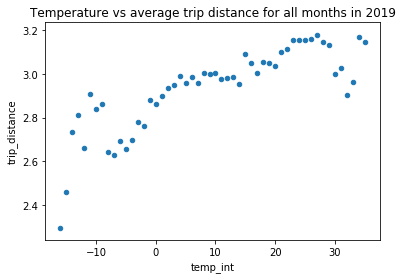

In [38]:
# plot the scatter plot for the average trip distance for each degree Celsius

distance_temp_df.plot.scatter(x='temp_int', y='trip_distance')
plt.title('Temperature vs average trip distance for all months in 2019')

plt.savefig('plots/Temperature_vs_average_trip_distance_for_all_months_in_2019.png')


plt.show()

#### Annual temperature & precipitation vs Tip_Amount (2019)

In [51]:
%%time
tip_series = pd.Series() 
prec_tip_series = pd.Series() 


for month in months:
    df = pd.read_feather(f'yellow_2019/yellow_tripdata_2019-{month}.feather').drop('index', axis=1)[['tpep_pickup_datetime','tip_amount']]
    df = df.loc[(df['tip_amount']>0) & (df['tip_amount']<10)]
    
    meta_df = pd.merge(df, weather_19, left_on='tpep_pickup_datetime', right_on='dt_iso').drop('dt_iso',axis=1)
    
    tip_without_prec = meta_df.loc[meta_df['tot_prec']==0]['tip_amount']
    tip_with_prec = meta_df.loc[meta_df['tot_prec']>0]['tip_amount']
    
    tip_series =tip_series.append(tip_without_prec)
    prec_tip_series = prec_tip_series.append(tip_with_prec)
    

CPU times: user 52.6 s, sys: 17.5 s, total: 1min 10s
Wall time: 30.4 s


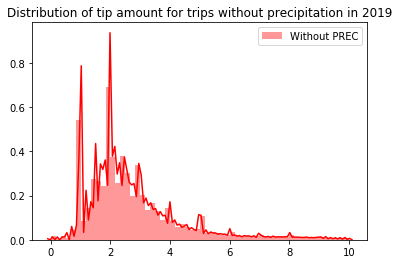

mean of tip amount without PREC: 2.76
variance of tip amount without PREC: 2.66


In [52]:
# plot distribution of tip amount for trips without precipitation in 2019
sns.distplot(tip_series, bins=60,label= 'Without PREC', color = 'red')
plt.title('Distribution of tip amount for trips without precipitation in 2019')


plt.legend()
plt.show()
print("mean of tip amount without PREC: {:.2f}".format(tip_series.mean()))
print("variance of tip amount without PREC: {:.2f}".format(tip_series.var()))



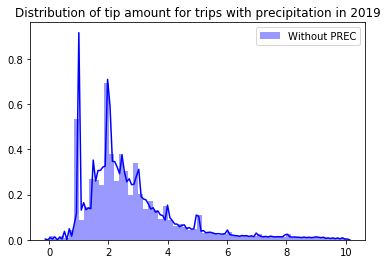

mean of tip amount with PREC: 2.77
variance of tip amount with PREC: 2.67


In [53]:
# plot distribution of tip amount for trips with precipitation in 2019

sns.distplot(prec_tip_series, bins=60,label= 'Without PREC', color = 'blue')

plt.title('Distribution of tip amount for trips with precipitation in 2019')


plt.legend()
plt.show()
print("mean of tip amount with PREC: {:.2f}".format(prec_tip_series.mean()))
print("variance of tip amount with PREC: {:.2f}".format(prec_tip_series.var()))



In [40]:
%%time

# this procedure is almost same as temperature vs average distance above, except the column used is 'tip_amount'
df_lst = []
weather_19['temp_int'] = weather_19['avg_temp'].astype(int)

for month in months:
    # read the file and select needed features
    df = pd.read_feather(f'yellow_2019/yellow_tripdata_2019-{month}.feather').drop('index', axis=1)[['tpep_pickup_datetime', 'tip_amount']]
    
    # merge df with weather_19 using the datetime, drop these two columns after merging
    meta_df = pd.merge(df, weather_19[['dt_iso','temp_int']], left_on='tpep_pickup_datetime', right_on='dt_iso').drop(['dt_iso','tpep_pickup_datetime'],axis=1)
    
    # append this dataframe to the df_lst
    df_lst.append(meta_df)
    
# concatenate all df in the df_lst to form a giant df with tip_amount and temperature for all months
all_month_tip = pd.concat(df_lst)




CPU times: user 37.3 s, sys: 13.1 s, total: 50.5 s
Wall time: 30.6 s


In [41]:
# group the giant dataframe by temperature using the mean tip amount
tip_temp_df =all_month_tip.groupby('temp_int').mean().reset_index()

In [42]:
tip_temp_df.head(2)

,temp_int,tip_amount
0,-16,1.820086
1,-15,1.830524


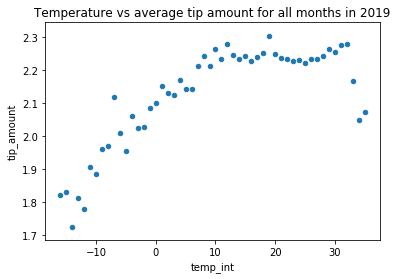

In [43]:
# plot the scatter plot for the average tip amount for each degree Celsius


tip_temp_df.plot.scatter(x='temp_int', y='tip_amount')
plt.title('Temperature vs average tip amount for all months in 2019')
plt.savefig('plots/Temperature_vs_average_tip_amount_for_all_months_in_2019.png')


plt.show()

#### Annual temperature & precipitation vs Spatial_Distribution (2019)

In [72]:
import folium
import geopandas as gpd

In [73]:
# the code below is copied from 'lab02'
import geopandas as gpd

# sf stands for shape file
sf = gpd.read_file("taxi_zones/taxi_zones.shp")
zone = pd.read_csv("taxi_zones/taxi+_zone_lookup.csv")
# joining two file via ID, not on string


# Convert geometry to long/lat 
sf['geometry'] = sf['geometry'].to_crs("+proj=longlat +ellps=WGS84 +datum=WGS84 +no_defs")



In [76]:
# combine all the dataframe for all months 
df_lst = []

for month in months:
    # read the file and select needed features
    df = pd.read_feather(f'yellow_2019/yellow_tripdata_2019-{month}.feather').drop('index', axis=1)[['tpep_pickup_datetime', 'DOLocationID']]
    
    # merge df with weather_19 using the datetime, drop these two columns after merging
    meta_df = pd.merge(df, weather_19[['dt_iso','avg_temp']], left_on='tpep_pickup_datetime', right_on='dt_iso').drop(['dt_iso','tpep_pickup_datetime'],axis=1)
    
    # append this dataframe to the df_lst
    df_lst.append(meta_df)
    
# concatenate all df in the df_lst to form a giant df with dropoff location ID and temperature for all months
all_month_loc_temp = pd.concat(df_lst)


In [77]:
all_month_loc_temp.tail(2)

,DOLocationID,avg_temp
7432321,216,6.295
7432322,216,6.295


In [78]:
# slicing the giant dataframe into 4 sub_dfs, take one with highest temperature and one with lowest temperature
fst_quantile = weather_19['avg_temp'].describe()['25%']
trd_quantile = weather_19['avg_temp'].describe()['75%']
sec_quantile = weather_19['avg_temp'].describe()['50%']

all_month_loc_high_temp = all_month_loc_temp.loc[all_month_loc_temp['avg_temp']>trd_quantile]
all_month_loc_low_temp = all_month_loc_temp.loc[all_month_loc_temp['avg_temp']<fst_quantile]

In [79]:
# creating a GeoDataFrame with df data and shapefile data. 
gdf_high = gpd.GeoDataFrame(pd.merge(all_month_loc_high_temp, sf, left_on='DOLocationID', right_on='LocationID')).drop('DOLocationID',axis=1)

# convert gdf to JSON format
geoJSON_high = gdf_high[['LocationID','geometry']].drop_duplicates('LocationID').to_json()

# create a dictionary with 'Location' and number of trips going to that location, and take log to the number
location_dict_high = all_month_loc_high_temp.groupby(['DOLocationID']).count().reset_index()[['DOLocationID','avg_temp' ]]
location_dict_high['avg_temp']= np.log(location_dict_high['avg_temp'])
 

In [80]:
# places.csv is written by myself, it contains the name of place and it's latitude and longitude
places = pd.read_csv('places.csv')
places.head(2)

,Place,Latitude,Longitude
0,Broad Channel American Park,40.596006,-73.822639
1,Jamaica Bay Wildlife Refuge,40.617162,-73.824070


In [95]:
# Choropleth Plot - high temperature 
m = folium.Map(location=[40.66, -73.94], tiles="Stamen Terrain", zoom_start=10)

# plot the point in the places.csv on the map
for point in range(0, len(places)):
        location = [places['Latitude'][point], places['Longitude'][point]]
        folium.Marker(location, popup=places['Place'][point]).add_to(m)

# plot the choropleth and also assign different colors to different regions by the dictionary created before
folium.Choropleth(
    geo_data=geoJSON_high,
    data = location_dict_high,
    name='choropleth',
    columns = ['DOLocationID','avg_temp' ],
    key_on='feature.properties.LocationID',
    fill_color='BuPu',
    fill_opacity=1,
    line_opacity=1,
    legend_name='Count (%)'
).add_to(m)
m.save('choropleth_plots/ChoroplethMap_high_temperature.html')
m

In [82]:
# creating a GeoDataFrame with df data and shapefile data. 
gdf_low = gpd.GeoDataFrame(pd.merge(all_month_loc_low_temp, sf, left_on='DOLocationID', right_on='LocationID')).drop('DOLocationID',axis=1)

# convert gdf to JSON format
geoJSON_low = gdf_low[['LocationID','geometry']].drop_duplicates('LocationID').to_json()


# create a dictionary with 'Location' and number of trips going to that location, and take log to the number
location_dict_low = all_month_loc_low_temp.groupby(['DOLocationID']).count().reset_index()[['DOLocationID','avg_temp' ]]
location_dict_low['avg_temp']= np.log(location_dict_low['avg_temp'])



In [83]:
# Choropleth Plot - low temperature
m = folium.Map(location=[40.66, -73.94], tiles="Stamen Terrain", zoom_start=10)

# plot the point in the places.csv on the map
for point in range(0, len(places)):
        location = [places['Latitude'][point], places['Longitude'][point]]
        folium.Marker(location, popup=places['Place'][point]).add_to(m)

# plot the choropleth and also assign different colors to different regions by the dictionary created before
folium.Choropleth(
    geo_data=geoJSON_low,    
    data = location_dict_low,
    name='choropleth',
    columns = ['DOLocationID','avg_temp' ],
    key_on='feature.properties.LocationID',
    fill_color='BuPu',
    fill_opacity=1,
    line_opacity=1,
    legend_name='Count (%)'
).add_to(m)

m.save('choropleth_plots/ChoroplethMap_low_temperature.html')
m

In [84]:
# combine all the dataframe for all months 
df_lst = []

for month in months:
    # read the file and select needed features
    df = pd.read_feather(f'yellow_2019/yellow_tripdata_2019-{month}.feather').drop('index', axis=1)[['tpep_pickup_datetime', 'DOLocationID']]
    
    # merge df with weather_19 using the datetime, drop these two columns after merging
    meta_df = pd.merge(df, weather_19[['dt_iso','tot_prec']], left_on='tpep_pickup_datetime', right_on='dt_iso').drop(['dt_iso','tpep_pickup_datetime'],axis=1)
    
    # append this dataframe to the df_lst
    df_lst.append(meta_df)
    
# concatenate all df in the df_lst to form a giant df with dropoff location ID and temperature for all months
all_month_loc_prec = pd.concat(df_lst)



In [85]:
all_month_loc_prec.tail(2)

,DOLocationID,tot_prec
7432321,216,0.23
7432322,216,0.23


In [86]:
# slicing the giant dataframe by whether it has any precipitation or not
all_month_loc_wth_prec = all_month_loc_prec.loc[all_month_loc_prec['tot_prec']>0]
all_month_loc_wo_prec = all_month_loc_prec.loc[all_month_loc_prec['tot_prec']==0]

In [87]:
# creating a GeoDataFrame with df data and shapefile data. 
gdf_wo_prec = gpd.GeoDataFrame(pd.merge(all_month_loc_wo_prec, sf, left_on='DOLocationID', right_on='LocationID')).drop('DOLocationID',axis=1)

# convert gdf to JSON format
geoJSON_wo_prec = gdf_wo_prec[['LocationID','geometry']].drop_duplicates('LocationID').to_json()

# create a dictionary with 'Location' and number of trips going to that location, and take log to the number
location_dict_wo_prec = all_month_loc_wo_prec.groupby(['DOLocationID']).count().reset_index()
location_dict_wo_prec['tot_prec']= np.log(location_dict_wo_prec['tot_prec'])


In [88]:
# Choropleth Plot - without precipitation
m = folium.Map(location=[40.66, -73.94], tiles="Stamen Terrain", zoom_start=10)

# plot the point in the places.csv on the map
for point in range(0, len(places)):
        location = [places['Latitude'][point], places['Longitude'][point]]
        folium.Marker(location, popup=places['Place'][point]).add_to(m)

# plot the choropleth and also assign different colors to different regions by the dictionary created before
folium.Choropleth(
    geo_data=geoJSON_wo_prec,
    data = location_dict_wo_prec,
    name='choropleth',
    columns = ['DOLocationID','tot_prec' ],
    key_on='feature.properties.LocationID',
    fill_color='BuPu',
    fill_opacity=1,
    line_opacity=1,
    legend_name='Count (%)'
).add_to(m)

m.save('choropleth_plots/ChoroplethMap_without_precipitation.html')
m

In [89]:
# creating a GeoDataFrame with df data and shapefile data. 
gdf_wth_prec = gpd.GeoDataFrame(pd.merge(all_month_loc_wth_prec, sf, left_on='DOLocationID', right_on='LocationID')).drop('DOLocationID',axis=1)

# convert gdf to JSON format
geoJSON_wth_prec = gdf_wth_prec[['LocationID','geometry']].drop_duplicates('LocationID').to_json()

# create a dictionary with 'Location' and number of trips going to that location, and take log to the number
location_dict_wth_prec = all_month_loc_wth_prec.groupby(['DOLocationID']).count().reset_index()
location_dict_wth_prec['tot_prec']= np.log(location_dict_wth_prec['tot_prec'])




In [90]:
# Choropleth Plot - with precipitation
m = folium.Map(location=[40.66, -73.94], tiles="Stamen Terrain", zoom_start=10)

# plot the point in the places.csv on the map
for point in range(0, len(places)):
        location = [places['Latitude'][point], places['Longitude'][point]]
        folium.Marker(location, popup=places['Place'][point]).add_to(m)

# plot the choropleth and also assign different colors to different regions by the dictionary created before
folium.Choropleth(
    geo_data=geoJSON_wth_prec,
    data = location_dict_wth_prec,
    name='choropleth',
    columns = ['DOLocationID','tot_prec' ],
    key_on='feature.properties.LocationID',
    fill_color='BuPu',
    fill_opacity=1,
    line_opacity=1,
    legend_name='Count (%)'
).add_to(m)

m.save('choropleth_plots/ChoroplethMap_with_precipitation.html')
m